<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Шаг--Загрузите-данные-и-изучите-общую-информацию" data-toc-modified-id="Шаг--Загрузите-данные-и-изучите-общую-информацию-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Шаг  Загрузите данные и изучите общую информацию</a></span></li><li><span><a href="#Шаг-Выполните-предобработку-данных" data-toc-modified-id="Шаг-Выполните-предобработку-данных-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Шаг Выполните предобработку данных</a></span></li><li><span><a href="#Шаг-Анализ-данных" data-toc-modified-id="Шаг-Анализ-данных-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Шаг Анализ данных</a></span></li><li><span><a href="#Шаг--Детализируем-исследование:-открытие-кофейни" data-toc-modified-id="Шаг--Детализируем-исследование:-открытие-кофейни-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Шаг  Детализируем исследование: открытие кофейни</a></span></li></ul></div>

# Рынок заведений общественного питания Москвы

В исследовании рынка заведений общественного питания Москвы учавствует инвестр из фонда «Shut Up and Take My Money», который хочет открыть заведение в Москве. Нам необходимо изучить рынок заведений по категории заведений, месту расположения, меню, цене. Презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места. 

Цель исследования:
    
- Исследовать: количество объектов общественного питания, количество посадочных мест в местах по категориям и АО.

- Проанализировать: соотношение сетевых и несетевых заведений в датасете; стоимость заказа в рублях по категориям и АО.

- Найти топ-15 популярных сетей , улиц в Москве по категориям и АО.

- Визуализировать распределение средних рейтингов по категориям заведений и АО.

- Найти улицы, на которых находится только один объект общепита.

- Сформулировать рекомендации о виде заведения, количестве посадочных мест, а также районе расположения нового объекта общественного питания.


Ход исследования:
Данные о заведениях общественного питания Москвы для иссследования я получу из файла /datasets/moscow_places.csv. Перед тем как приступить к исследованию, необходимо проверить общую информацию о датасете.
После анализа предоставленных данных,  провожу предобработку данных: ищу явных и неявных дубликаты, заполняю пропущенные данные в столбцах, перевожу столбцы в нужный регистр, отбрасываю значения с аномальными значениями, добавляю нужные для анализа столбцы и приступаю к сисследованию.

Исследование пройдет в 5 этапов:
- Обзор данных
- Предобработка данных
- Анализ данных
- Детализируем исследование: открытие кофейни
- Выводы на основании исследований

In [1]:
# импорт библиотек
import pandas as pd
import numpy as np
from scipy import stats as st
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from plotly import graph_objects as go
import plotly.express as px
import re

In [2]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [3]:
# загружаем данные 
try:
    path = 'B://Downloads//'
    df = pd.read_csv(path + 'moscow_places.csv') 

    
except:
    df = pd.read_csv('/datasets/moscow_places.csv') 

**Описание данных**

Файл moscow_places.csv:
- name — название заведения;
- address — адрес заведения;
- category — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- hours — информация о днях и часах работы;
- lat — широта географической точки, в которой находится заведение;
- lng — долгота географической точки, в которой находится заведение;
- rating — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- price — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- avg_bill — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
   - «Средний счёт: 1000–1500 ₽»;
   - «Цена чашки капучино: 130–220 ₽»;
   - «Цена бокала пива: 400–600 ₽».
   - и так далее;
- middle_avg_bill — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
   - Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
   - Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
   - Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
- middle_coffee_cup — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
   - Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
   - Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
   - Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
- chain — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
   - 0 — заведение не является сетевым
   - 1 — заведение является сетевым
- district — административный район, в котором находится заведение, например Центральный административный округ;
- seats — количество посадочных мест.

**Инструкция по выполнению проекта**

### Шаг  Загрузите данные и изучите общую информацию
Загрузите данные о заведениях общественного питания Москвы.
Путь к файлу: /datasets/moscow_places.csv. Скачать датасет.

In [4]:
df

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0


Изучите общую информацию о датасете. Сколько заведений представлено? Что можно сказать о каждом столбце? Значения какого типа они хранят? 

In [5]:
df.shape

(8406, 14)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Загрузили данные о заведениях общественного питания Москвы, которые хранятся файле: /datasets/moscow_places.csv.

Изучили общую информацию о датасете: **8406** строк и **14** столбцов. 8406 заведений представлено в датасете. 

**7** столбцов имеют тип данных **object**: name, category, address, district, hours, price, avg_bill.

**6** столбцов имеют тип данных **float64**: lat, lng, rating, middle_avg_bill, middle_coffee_cup, seats. 

Один столбец - chain имеет тип данных **int64**.

В **6** стобцах представлены не полные данные: hours(7870), price(3315), avg_bill(3816), middle_avg_bill(3149),  middle_coffee_cup(535), seats(4795). 

### Шаг Выполните предобработку данных


In [7]:
# выводим информацию о данных
display(df.head())
display(df.info())
display(df.describe())
print('Количество дублей:', df.duplicated().sum())

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


None

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406.000000,8406.000000,8406.000000,3149.000000,535.000000,8406.000000,4795.000000
mean,55.750109,37.608570,4.229895,958.053668,174.721495,0.381275,108.421689
std,0.069658,0.098597,0.470348,1009.732845,88.951103,0.485729,122.833396
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.705155,37.538583,4.100000,375.000000,124.500000,0.000000,40.000000
50%,55.753425,37.605246,4.300000,750.000000,169.000000,0.000000,75.000000
75%,55.795041,37.664792,4.400000,1250.000000,225.000000,1.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,1288.000000


Количество дублей: 0


In [8]:
# узнаем сколько в каждом столбце пропусков
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

In [9]:
# подсчитаем в процентном отношении пропуски в каждом столбце
df.isna().mean()*100

name                  0.000000
category              0.000000
address               0.000000
district              0.000000
hours                 6.376398
lat                   0.000000
lng                   0.000000
rating                0.000000
price                60.563883
avg_bill             54.603854
middle_avg_bill      62.538663
middle_coffee_cup    93.635498
chain                 0.000000
seats                42.957411
dtype: float64

In [10]:
# создаем столбец street с названиями улиц из столбца с адресом
words = ['улица','ул','переулок','шоссе','проспект','площадь','проезд',
         'село','аллея','бульвар','набережная','тупик','линия']

str_pat = r".*,\s*\b([^,]*?(?:{})\b[^,]*)[,$]+".format("|".join(words))

df["street"] = df["address"].str.extract(str_pat, flags=re.I)

In [11]:
# Создаем столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
    #логическое значение True — если заведение работает ежедневно и круглосуточно;
    #логическое значение False — в противоположном случае.

def hours_true_false(x):
    if x=='ежедневно, круглосуточно':
        return True
    elif x!='ежедневно, круглосуточно':
        return False
    
df['is_24/7'] = df['hours'].apply(hours_true_false)

In [12]:
df.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False


In [13]:
# создаем новый столбец district_new из столбца district с сокращенными названиями административных округов
def district_new(district):
    try:
        if district == 'Южный административный округ':
            return 'ЮАО'
        elif district == 'Юго-Западный административный округ':
            return 'ЮЗАО'
        elif district == 'Юго-Восточный административный округ':
            return 'ЮВАО'
        elif district == 'Центральный административный округ':
            return 'ЦАО'
        elif district == 'Северо-Западный административный округ':
            return 'СЗАО'
        elif district == 'Северо-Восточный административный округ':
            return 'СВАО'
        elif district == 'Северный административный округ':
            return 'САО'
        elif district == 'Западный административный округ':
            return 'ЗАО'
        elif district == 'Восточный административный округ':
            return 'ВАО'
    except:
        pass    
df['district_new'] = df['district'].apply(district_new) 

In [14]:
# выявляем неявные дубликаты в столбце name
df['name'].nunique()

5614

In [15]:
# переводим столбец name в нижний регистр
df['name'] = df['name'].str.lower()

In [16]:
# проверяем столбец name 
df['name'].nunique()

5512

In [17]:
# меняем в столбце name с буквой ё на букву е
df['name'] = df['name'].map(lambda x: x.replace('ё', 'е')) # меняем в словах с буквой ё на букву е

In [18]:
# проверяем столбец name 
df['name'].nunique()

5506

In [19]:
# заменяем неявные дубликаты в столбце name
df['name'] = df['name'].replace(['яндекс.лавка'], 'яндекс лавка')
df['name'] = df['name'].replace(['кулинарная лавка братьев караваевых'], 'к.л братьев караваевых')
df['name'] = df['name'].replace(["доминос пицца"], "домино'с пицца")
df['name'] = df['name'].replace(["drive cafe"], "drive café")
df['name'] = df['name'].replace(["кафе столовая"], "кафе-столовая")
df['name'] = df['name'].replace(["кафе бар"], "кафе-бар")
df['name'] = df['name'].replace(["чайхона №1"], "чайхона № 1")

In [20]:
# проверяем столбец name 
df['name'].nunique()

5500

In [21]:
# заполняем пропуски в столбце street
df['street'] = df['street'].fillna('неизвестен')

In [22]:
# заполняем пропуски в столбце hours
df['hours'] = df['hours'].fillna('неизвестен')

In [23]:
# заполняем пропуски в столбце price
df['price'] = df['price'].fillna('неизвестен')

In [24]:
# заполняем пропуски в столбце avg_bill
df['avg_bill'] = df['avg_bill'].fillna('неизвестен')

In [25]:
#уберем 1% аномальных значений в столбце seats
df = df[~(df['seats'] > np.nanpercentile(df['seats'], 99))]
df

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,district_new
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,неизвестен,неизвестен,NaN,NaN,0,NaN,улица Дыбенко,False,САО
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False,САО
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False,САО
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,неизвестен,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False,САО
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False,САО
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,суши мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,неизвестен,неизвестен,NaN,NaN,0,86.0,Профсоюзная улица,False,ЮЗАО
8402,миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,неизвестен,неизвестен,NaN,NaN,0,150.0,Пролетарский проспект,False,ЮАО
8403,самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,неизвестен,Средний счёт:от 150 ₽,150.0,NaN,0,150.0,Люблинская улица,True,ЮВАО
8404,чайхана sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,неизвестен,неизвестен,NaN,NaN,1,150.0,Люблинская улица,True,ЮВАО


In [26]:
#уберем 1% аномальных значений  в столбце middle_coffee_cup
df = df[~(df['middle_coffee_cup'] > np.nanpercentile(df['middle_coffee_cup'], 99))]
df

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,district_new
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,неизвестен,неизвестен,NaN,NaN,0,NaN,улица Дыбенко,False,САО
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False,САО
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False,САО
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,неизвестен,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False,САО
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False,САО
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,суши мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,неизвестен,неизвестен,NaN,NaN,0,86.0,Профсоюзная улица,False,ЮЗАО
8402,миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,неизвестен,неизвестен,NaN,NaN,0,150.0,Пролетарский проспект,False,ЮАО
8403,самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,неизвестен,Средний счёт:от 150 ₽,150.0,NaN,0,150.0,Люблинская улица,True,ЮВАО
8404,чайхана sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,неизвестен,неизвестен,NaN,NaN,1,150.0,Люблинская улица,True,ЮВАО


In [27]:
#уберем 1% аномальных значений в столбце middle_avg_bill
df = df[~(df['middle_avg_bill'] > np.nanpercentile(df['middle_avg_bill'], 99))]
df

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,district_new
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,неизвестен,неизвестен,NaN,NaN,0,NaN,улица Дыбенко,False,САО
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False,САО
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False,САО
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,неизвестен,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False,САО
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False,САО
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,суши мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,неизвестен,неизвестен,NaN,NaN,0,86.0,Профсоюзная улица,False,ЮЗАО
8402,миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,неизвестен,неизвестен,NaN,NaN,0,150.0,Пролетарский проспект,False,ЮАО
8403,самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,неизвестен,Средний счёт:от 150 ₽,150.0,NaN,0,150.0,Люблинская улица,True,ЮВАО
8404,чайхана sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,неизвестен,неизвестен,NaN,NaN,1,150.0,Люблинская улица,True,ЮВАО


In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8340 entries, 0 to 8405
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8340 non-null   object 
 1   category           8340 non-null   object 
 2   address            8340 non-null   object 
 3   district           8340 non-null   object 
 4   hours              8340 non-null   object 
 5   lat                8340 non-null   float64
 6   lng                8340 non-null   float64
 7   rating             8340 non-null   float64
 8   price              8340 non-null   object 
 9   avg_bill           8340 non-null   object 
 10  middle_avg_bill    3113 non-null   float64
 11  middle_coffee_cup  528 non-null    float64
 12  chain              8340 non-null   int64  
 13  seats              4740 non-null   float64
 14  street             8340 non-null   object 
 15  is_24/7            8340 non-null   bool   
 16  district_new       8340 

In [29]:
df.head(100)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,district_new
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,неизвестен,неизвестен,NaN,NaN,0,NaN,улица Дыбенко,False,САО
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False,САО
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False,САО
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,неизвестен,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False,САО
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False,САО
5,sergio pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,неизвестен,NaN,NaN,0,NaN,Ижорская улица,False,САО
6,огни города,"бар,паб","Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.890752,37.524653,4.4,средние,Средний счёт:199 ₽,199.0,NaN,0,45.0,Клязьминская улица,False,САО
7,mr. уголек,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.890636,37.524303,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN,0,45.0,Клязьминская улица,False,САО
8,donna maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,0,79.0,Дмитровское шоссе,False,САО
9,готика,кафе,"Москва, Ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.879038,37.524487,4.3,средние,Средний счёт:1000–1200 ₽,1100.0,NaN,0,65.0,Ангарская улица,False,САО


In [30]:
# проверяем неявные дубликаты по столбцам name, address
df[df.duplicated(subset=['name','address'])]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,district_new
1511,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,неизвестен,неизвестен,NaN,NaN,1,188.0,Волоколамское шоссе,False,САО
2420,раковарня клешни и хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,неизвестен,неизвестен,NaN,NaN,1,150.0,проспект Мира,False,СВАО
3109,хлеб да выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,неизвестен,55.738449,37.410937,4.1,неизвестен,неизвестен,NaN,NaN,0,276.0,Ярцевская улица,False,ЗАО


In [31]:
# удаляем неявные дубликаты по столбцам name, address
df=df.drop_duplicates(subset=['name','address'])

In [32]:
# проверяем неявные дубликаты по столбцам name, address
df[df.duplicated(subset=['name','address'])]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,district_new


In [33]:
# проверяем неявные дубликаты по столбцам name, lat, lng
df[df.duplicated(subset=['name','lat','lng'])]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,district_new


In [34]:
# проверяем неявные дубликаты по столбцам name, category
df[df.duplicated(subset=['name','category'])]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,district_new
23,буханка,булочная,"Москва, Лобненская улица, 13к2",Северный административный округ,"ежедневно, 08:00–22:00",55.888421,37.527106,4.7,неизвестен,неизвестен,NaN,NaN,1,NaN,Лобненская улица,False,САО
47,кафе,кафе,"Москва, улица Маршала Федоренко, 7",Северный административный округ,"ежедневно, 11:00–00:00",55.880306,37.489760,2.8,неизвестен,неизвестен,NaN,NaN,0,35.0,улица Маршала Федоренко,False,САО
71,cofefest,кофейня,"Москва, Новгородская улица, 23А",Северо-Восточный административный округ,пн-пт 08:00–19:00,55.901799,37.577672,4.1,неизвестен,неизвестен,NaN,NaN,1,NaN,Новгородская улица,False,СВАО
75,хинкали-gали!,кафе,"Москва, Дмитровское шоссе, 100",Северный административный округ,"ежедневно, 12:00–23:00",55.881626,37.545617,4.9,неизвестен,неизвестен,NaN,NaN,1,NaN,Дмитровское шоссе,False,САО
94,домино'с пицца,пиццерия,"Москва, Абрамцевская улица, 30, стр. 6",Северо-Восточный административный округ,"пн-пт 11:00–22:00; сб,вс 10:00–22:00",55.905994,37.576284,4.2,средние,неизвестен,NaN,NaN,1,16.0,Абрамцевская улица,False,СВАО
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8274,ли,кафе,"Москва, Рязанский проспект, 30, корп. 2",Юго-Восточный административный округ,"ежедневно, 10:30–21:00",55.718076,37.783650,4.7,неизвестен,неизвестен,NaN,NaN,1,116.0,Рязанский проспект,False,ЮВАО
8317,беседка,кафе,"Москва, Кузьминская улица, 10",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690691,37.787735,4.1,неизвестен,неизвестен,NaN,NaN,1,NaN,Кузьминская улица,False,ЮВАО
8339,чайхана бишкек сити,кафе,"Москва, Волгоградский проспект, 177",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.701962,37.795696,3.9,неизвестен,неизвестен,NaN,NaN,0,NaN,Волгоградский проспект,True,ЮВАО
8379,лагман хаус,кафе,"Москва, Новороссийская улица, 14, стр. 2",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.678772,37.759422,4.3,неизвестен,неизвестен,NaN,NaN,1,40.0,Новороссийская улица,False,ЮВАО


При обработке данных не было обнаружены дубликаты. Добавлены в датасет столбцы:street, is_24/7, district_new. В столбце name были исправлены неявные дубликаты. В столбцах: street, hours, price, avg_bill поставили заглушки 'неизвестен'. В столбцах: seats, middle_coffee_cup, middle_avg_bill убрали 1% аномальных значений.

### Шаг Анализ данных

- Какие категории заведений представлены в данных? Исследуйте количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Ответьте на вопрос о распределении заведений по категориям.
- Исследуйте количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Проанализируйте результаты и сделайте выводы.
- Рассмотрите и изобразите соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?
- Какие категории заведений чаще являются сетевыми? Исследуйте данные и ответьте на вопрос графиком.
- Сгруппируйте данные по названиям заведений и найдите топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Постройте подходящую для такой информации визуализацию. Знакомы ли вам эти сети? Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?
- Какие административные районы Москвы присутствуют в датасете? Отобразите общее количество заведений и количество заведений каждой категории по районам. Попробуйте проиллюстрировать эту информацию одним графиком.
- Визуализируйте распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?
- Постройте фоновую картограмму (хороплет) со средним рейтингом заведений каждого района. Границы районов Москвы, которые встречаются в датасете, хранятся в файле admin_level_geomap.geojson (скачать файл для локальной работы).
- Отобразите все заведения датасета на карте с помощью кластеров средствами библиотеки folium.
- Найдите топ-15 улиц по количеству заведений. Постройте график распределения количества заведений и их категорий по этим улицам. Попробуйте проиллюстрировать эту информацию одним графиком.
- Найдите улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?
- Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. Посчитайте медиану этого столбца для каждого района. Используйте это значение в качестве ценового индикатора района. Постройте фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализируйте цены в центральном административном округе и других. Как удалённость от центра влияет на цены в заведениях?
- Необязательное задание: проиллюстрируйте другие взаимосвязи, которые вы нашли в данных. Например, по желанию исследуйте часы работы заведений и их зависимость от расположения и категории заведения. Также можно исследовать особенности заведений с плохими рейтингами, средние чеки в таких местах и распределение по категориям заведений.

- Соберите наблюдения по вопросам выше в один общий вывод.

Какие категории заведений представлены в данных? Исследуйте количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Ответьте на вопрос о распределении заведений по категориям.

In [35]:
# готовим данные для графика
df_category = df['category'].value_counts().reset_index().sort_values(by = 'category', ascending=False)
df_category.rename(columns = {'index': 'category', 'category':'count'}, inplace = True)
df_category

,category,count
0,кафе,2368
1,ресторан,2012
2,кофейня,1402
3,"бар,паб",752
4,пиццерия,632
5,быстрое питание,601
6,столовая,314
7,булочная,256


In [36]:
# строим столбчатую диаграмму 
fig = px.bar(df_category.sort_values(by='count', ascending=False), # загружаем данные и заново их сортируем
             x='category', # указываем столбец с данными для оси X
             y='count', # указываем столбец с данными для оси Y
             text='count', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color='category', # обозначаем категорию для разделения цветом
            )
# оформляем график
fig.update_layout(title='Количество заведений по категориям',
                   xaxis_title='Категории заведений',
                   yaxis_title='Количество заведений')
fig.show() # выводим график

Общее количество заведений - 8340 шт. Больше всего заведений по категориям питания: кафе(2369), ресторан(2013), кофейня(1402).


Исследуйте количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Проанализируйте результаты и сделайте выводы.

In [37]:
# готовим данные для графика
df_category_seats =pd.pivot_table(df, index=['category'], values=['seats'], aggfunc='median').reset_index().sort_values(by='seats', ascending=False)
df_category_seats

,category,seats
6,ресторан,85.0
0,"бар,паб",80.0
4,кофейня,80.0
7,столовая,75.0
2,быстрое питание,65.0
3,кафе,60.0
5,пиццерия,53.5
1,булочная,50.0


In [38]:
df['seats'].median()

75.0

In [39]:
# строим столбчатую диаграмму 
fig = px.bar(df_category_seats.sort_values(by='seats', ascending=False), # загружаем данные и заново их сортируем
             y='seats', # указываем столбец с данными для оси X
             x='category', # указываем столбец с данными для оси Y
             text='seats', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color='category', # обозначаем категорию для разделения цветом
            )
# оформляем график
fig.update_layout(title='Количество посадочных мест по категориям',
                   xaxis_title='Категории заведений',
                   yaxis_title='Количество мест')
fig.show() # выводим график

Больше всего посадочных мест у заведений категории: ресторан(85), бар,паб(80), кофейня(80). Меньше всего посадочных мест у булочных(50).

Рассмотрите и изобразите соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?

In [40]:
# готовим данные для графика
df_category_chain =pd.pivot_table(df, index=['chain'], values=['category'], aggfunc='count').reset_index().sort_values(by='chain', ascending=False)
df_category_chain

,chain,category
1,1,3186
0,0,5151


In [41]:
# строим столбчатую диаграмму 
fig = px.bar(df_category_chain.sort_values(by='category', ascending=False), # загружаем данные и заново их сортируем
             x='chain', # указываем столбец с данными для оси X
             y='category', # указываем столбец с данными для оси Y
             text='category', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color='chain', # обозначаем категорию для разделения цветом
            )
# оформляем график
fig.update_layout(title='Количество сетевых и несетевых заведений',
                   xaxis_title='Сетевые и несетевые заведения',
                   yaxis_title='Количество заведений')
fig.show() # выводим график

Не сетевых 5151(62%) заведений больше, чем сетевых- 3186(38%). 

Какие категории заведений чаще являются сетевыми? Исследуйте данные и ответьте на вопрос графиком.

In [42]:
# формируем данные по сетевым заведениям
df_chain = df[df['chain'] == 1].groupby('category')['chain'].count().reset_index().sort_values(by='chain', ascending=False)
df_chain

,category,chain
3,кафе,777
6,ресторан,723
4,кофейня,714
5,пиццерия,329
2,быстрое питание,230
0,"бар,паб",168
1,булочная,157
7,столовая,88


In [43]:
# считаем количество сетевых и несетевых заведений с разбивкой по категориям
users_df = df.groupby(['category', 'chain'])['name'].count().reset_index().sort_values(by='name', ascending=False)
users_df

,category,chain,name
6,кафе,0,1591
12,ресторан,0,1289
7,кафе,1,777
13,ресторан,1,723
9,кофейня,1,714
8,кофейня,0,688
0,"бар,паб",0,584
4,быстрое питание,0,371
11,пиццерия,1,329
10,пиццерия,0,303


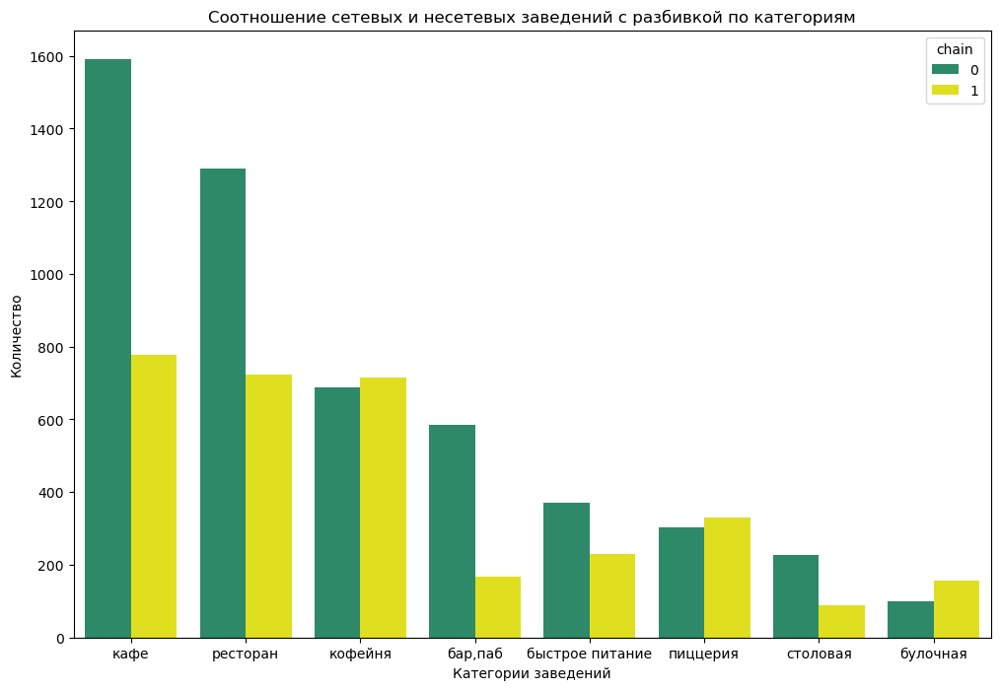

In [44]:
# построим график соотношения сетевых и несетевых заведений с разбивкой по категориям
plt.figure(figsize=(12, 8))

# задание параметров построения графика
ax = sns.barplot(x=users_df.category,
                 y=users_df.name,
                 color='#6925c2',
                 palette=['#1f986c', '#ffff00', '#ff00ff'],
                 hue=users_df.chain)            
              
# подписи осей и названия
ax.set (xlabel='Категории заведений',
        ylabel='Количество',
        title='Cоотношение сетевых и несетевых заведений с разбивкой по категориям');

In [45]:
# находим соотношение сетевых от общего количества заведений
df_chain_tab = df.groupby(['category'])['chain'].count().reset_index().sort_values(by='chain', ascending=False)
df_chain_tab['chain1'] = df_chain['chain']
df_chain_tab['ratio'] = df_chain_tab['chain1'] / df_chain_tab['chain']*100
df_chain_tab.rename(columns = {'chain':'count', 'chain1':'chain' }, inplace = True)
df_chain_tab.sort_values(by='ratio', ascending=False).round(2)

,category,count,chain,ratio
1,булочная,256,157,61.33
5,пиццерия,632,329,52.06
4,кофейня,1402,714,50.93
2,быстрое питание,601,230,38.27
6,ресторан,2012,723,35.93
3,кафе,2368,777,32.81
7,столовая,314,88,28.03
0,"бар,паб",752,168,22.34


In [46]:
# строим столбчатую диаграмму 
fig = px.bar(df_chain_tab.sort_values(by='ratio', ascending=False).round(2), # загружаем данные и заново их сортируем
             x='category', # указываем столбец с данными для оси X
             y='ratio', # указываем столбец с данными для оси Y
             text='ratio', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color='ratio', # обозначаем категорию для разделения цветом
            )
# оформляем график
fig.update_layout(title='Доля сетевых заведений по категориям',
                   xaxis_title='Категории заведений',
                   yaxis_title='Доля сетевых заведений')
fig.show() # выводим график

Наибольшая доля сетевых заведений у булочных - 61 %, пиццерий - 52% и кофеен -51%. Самая маленькая доля сетевых заведений у бар,паб – 22%.

Сгруппируйте данные по названиям заведений и найдите топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Постройте подходящую для такой информации визуализацию. Знакомы ли вам эти сети? Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?

In [47]:
# формируем данные по сетевым заведениям
top_15 = df[df['chain'] == True]
top_15

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,district_new
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False,САО
13,буханка,булочная,"Москва, Базовская улица, 15, корп. 1",Северный административный округ,"ежедневно, 08:00–22:00",55.877007,37.504980,4.8,неизвестен,неизвестен,NaN,NaN,1,180.0,Базовская улица,False,САО
19,пекарня,булочная,"Москва, Ижорский проезд, 5",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,неизвестен,неизвестен,NaN,NaN,1,NaN,Ижорский проезд,True,САО
20,чебуреки манты,кафе,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.880287,37.448646,4.3,неизвестен,неизвестен,NaN,NaN,1,148.0,Правобережная улица,False,САО
23,буханка,булочная,"Москва, Лобненская улица, 13к2",Северный административный округ,"ежедневно, 08:00–22:00",55.888421,37.527106,4.7,неизвестен,неизвестен,NaN,NaN,1,NaN,Лобненская улица,False,САО
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8317,беседка,кафе,"Москва, Кузьминская улица, 10",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690691,37.787735,4.1,неизвестен,неизвестен,NaN,NaN,1,NaN,Кузьминская улица,False,ЮВАО
8340,семейный очаг,ресторан,"Москва, Шоссейная улица, 13",Юго-Восточный административный округ,"ежедневно, 12:00–00:00",55.688104,37.725197,4.3,средние,Средний счёт:до 1000 ₽,1000.0,NaN,1,98.0,Шоссейная улица,False,ЮВАО
8372,чайхана sabr,ресторан,"Москва, улица Хлобыстова, 22",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.716361,37.813436,3.9,средние,Средний счёт:150–350 ₽,250.0,NaN,1,32.0,улица Хлобыстова,False,ЮВАО
8379,лагман хаус,кафе,"Москва, Новороссийская улица, 14, стр. 2",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.678772,37.759422,4.3,неизвестен,неизвестен,NaN,NaN,1,40.0,Новороссийская улица,False,ЮВАО


In [48]:
# группируем данные 15 сетевых заведений 
df_district_new_name15 = top_15.groupby(['name'], \
                        as_index = False)[['district_new']].count().sort_values(by='district_new', ascending=False)
df_district_new_name15.head(15)

,name,district_new
728,шоколадница,116
335,домино'с пицца,76
331,додо пицца,74
741,яндекс лавка,71
146,one price coffee,70
58,cofix,65
168,prime,50
664,хинкальная,44
411,кофепорт,42
369,к.л братьев караваевых,39


In [49]:
# формируем список топ-15 сетевых заведений 
df_name_15 = ['шоколадница', "домино'с пицца", 'додо пицца', 'яндекс лавка','one price coffee', 'cofix',\
              'prime', 'хинкальная', 'кофепорт', 'к.л братьев караваевых', 'теремок', 'чайхана',\
              'cofefest', 'буханка', 'му-му']
df_name_15 = top_15.query('name in @df_name_15')

In [50]:
# группируем данные сетевые заведения по административным округам
df_district_new_name = df_name_15.groupby(['district_new'], \
                        as_index = False)[['name']].count().sort_values(by='name', ascending=False)
df_district_new_name

,district_new,name
5,ЦАО,215
6,ЮАО,89
2,САО,87
1,ЗАО,86
3,СВАО,85
0,ВАО,78
8,ЮЗАО,70
7,ЮВАО,56
4,СЗАО,47


In [51]:
# строим столбчатую диаграмму 
fig = px.bar(df_district_new_name.sort_values(by='name', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             text='name', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color = 'district_new'
            )
# оформляем график
fig.update_layout(title='Топ-15 сетевых заведений по административным округам',
                   xaxis_title='Административные округа',
                   yaxis_title='Количество заведений')
fig.show() # выводим график

In [52]:
# считаем количество сетевых заведений по административным округам
df_district_new_count15 = df_name_15.groupby(['name', 'district_new'], \
                        as_index = False)[['category']].count().sort_values(by='category', ascending=False)
df_district_new_count15

,name,district_new,category
113,шоколадница,ЦАО,38
32,prime,ЦАО,37
64,к.л братьев караваевых,ЦАО,32
14,cofix,ЦАО,20
109,шоколадница,ЗАО,16
78,му-му,ЦАО,15
23,one price coffee,ЦАО,15
71,кофепорт,ЦАО,15
95,хинкальная,ЦАО,14
110,шоколадница,САО,13


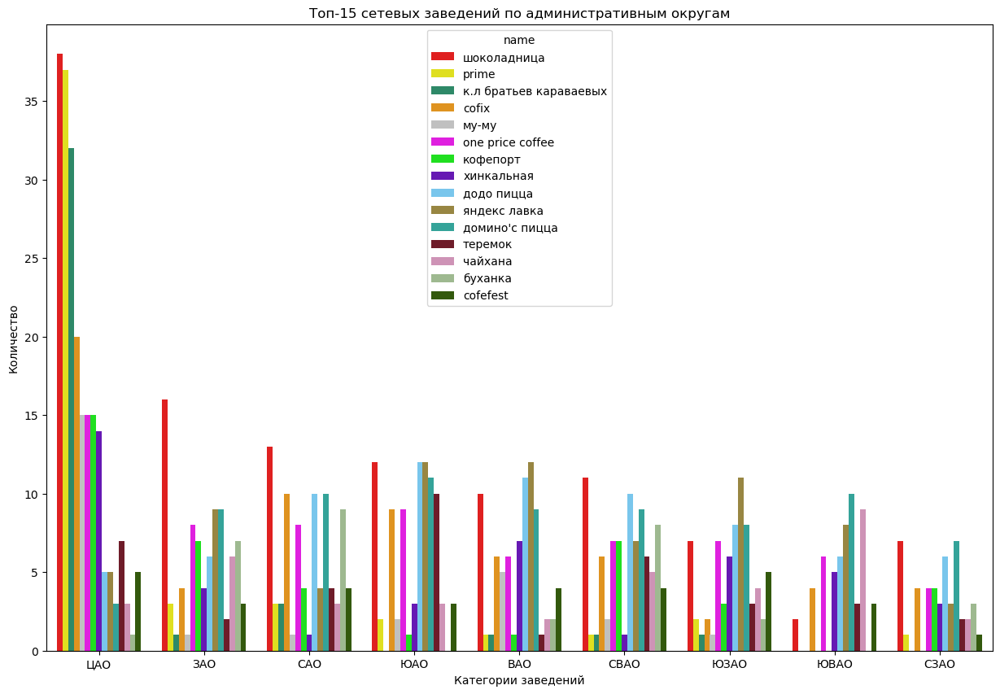

In [53]:
# построим график топ-15 сетевых заведений с разбивкой по категориям
plt.figure(figsize=(15, 10))

# задание параметров построения графика
ax = sns.barplot(x=df_district_new_count15.district_new,
                 y=df_district_new_count15.category,
                 color='#6925c2',
                 palette=['#FF0000', '#ffff00', '#1f986c', '#FF9900', '#C0C0C0', '#ff00ff', '#00FF00', '#6600CC',\
                          '#66CCFF', '#A68E34', '#21B6A8', '#7B0F20', '#D889B8', '#9CC089', '#336600'],
                 hue=df_district_new_count15.name)            
              
# подписи осей и названия
ax.set (xlabel='Категории заведений',
        ylabel='Количество',
        title='Топ-15 сетевых заведений по административным округам');

В ЦАО(37), ЗАО(16), САО(13) , ЮАО(12) , СВАО(11), СЗАО(7) лидирует – шоколадница.  В ЦАО(37) еще лидирует –prime.
В ЮАО(12), ВАО(12), ЮЗАО(11) лидирует - яндекс лавка. В ЮАО(12) еще лидирует - додо пицца. В ЮВАО(10) , СЗАО(7) лидирует - домино'с пицца.


In [54]:
# строим столбчатую диаграмму 
fig = px.bar(df_district_new_count15.sort_values(by='category', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             text='category', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color = 'name'
            )
# оформляем график
fig.update_layout(title='Топ-15 заведений по административным округам',
                   xaxis_title='Административные округа',
                   yaxis_title='Количество заведений')
fig.show() # выводим график

В 2 раза больше сетевых заведений в ЦАО(215), по сравнению с другими административными округами. 
Меньше всего СЗАО(47).


К какой категории заведений они относятся?

In [55]:
# группируем данные 15 сетевых заведений по категориям
df_district_new_name = df_name_15.groupby(['category'], \
                        as_index = False)[['name']].count().sort_values(by='name', ascending=False)
df_district_new_name

,category,name
4,кофейня,331
6,ресторан,188
5,пиццерия,151
3,кафе,100
1,булочная,25
2,быстрое питание,12
0,"бар,паб",4
7,столовая,2


In [56]:
# строим столбчатую диаграмму 
fig = px.bar(df_district_new_name.sort_values(by='name', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='category', # указываем столбец с данными для оси Y
             text='name', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color = 'category'
            )
# оформляем график
fig.update_layout(title='Топ-15 сетевых заведений по категориям',
                   xaxis_title='Категории заведений',
                   yaxis_title='Количество заведений')
fig.show() # выводим график

In [57]:
# считаем количество заведений по категориям
df_category_count15 = df_name_15.groupby(['name', 'category'], \
                        as_index = False)[['district_new']].count().sort_values(by='district_new', ascending=False)
df_category_count15

,name,category,district_new
31,шоколадница,кофейня,115
10,домино'с пицца,пиццерия,76
9,додо пицца,пиццерия,74
32,яндекс лавка,ресторан,71
3,one price coffee,кофейня,70
2,cofix,кофейня,65
5,prime,ресторан,49
12,кофепорт,кофейня,42
11,к.л братьев караваевых,кафе,39
21,теремок,ресторан,36


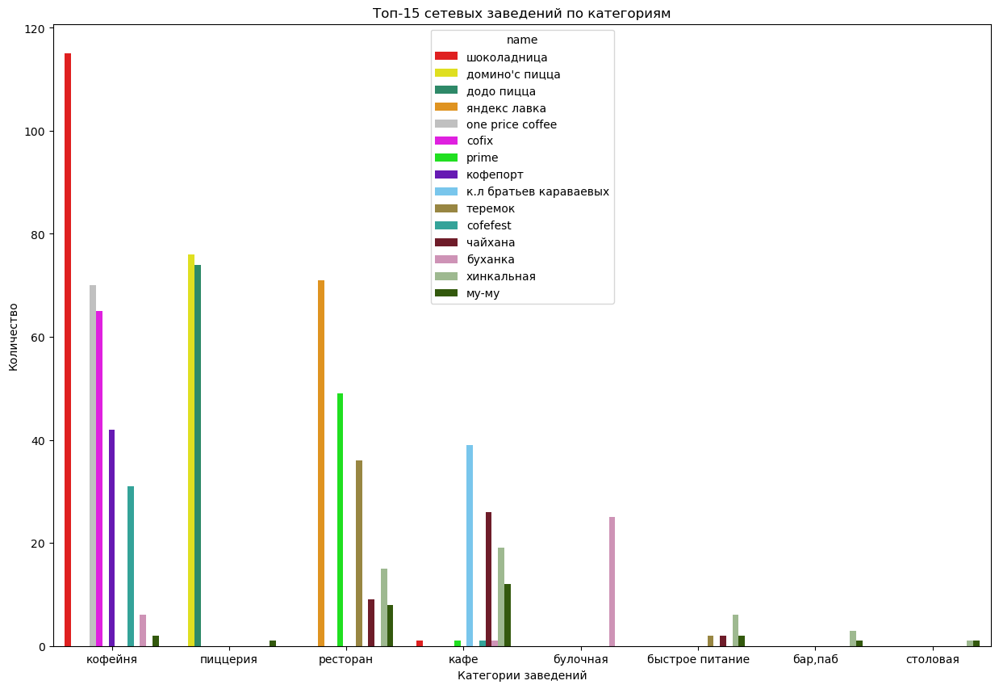

In [58]:
# построим график топ-15 сетевых заведений с разбивкой по категориям
plt.figure(figsize=(15, 10))

# задание параметров построения графика
ax = sns.barplot(y=df_category_count15.district_new,
                 x=df_category_count15.category,
                 color='#6925c2',
                 palette=['#FF0000', '#ffff00', '#1f986c', '#FF9900', '#C0C0C0', '#ff00ff', '#00FF00', '#6600CC',\
                          '#66CCFF', '#A68E34', '#21B6A8', '#7B0F20', '#D889B8', '#9CC089', '#336600'],
                 hue=df_category_count15.name)            
              
# подписи осей и названия
ax.set (xlabel='Категории заведений',
        ylabel='Количество',
        title='Топ-15 сетевых заведений по категориям');

На 1 месте кофейни: шоколадница(115), one price, coffee(70), cofix(65). На 2 месте пиццерии : домино'с пицца(76), додо пицца(74). На 3 месте ресторан яндекс лавка(71). Меньше всего бар,паб и столовых.


In [59]:
# строим столбчатую диаграмму

fig = px.bar(df_category_count15.sort_values(by='district_new', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='category', # указываем столбец с данными для оси Y
             text='district_new', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color = 'name'
            )
# оформляем график
fig.update_layout(title='Топ-15 заведений по категориям',
                   xaxis_title='Категории заведений',
                   yaxis_title='Количество заведений')
fig.show() # выводим график

1 место -кофейня(331),   2 место - ресторан(188), 3 место - пиццерия(151). На последнем месте бар,паб (4) и столовая(2).


Какие административные районы Москвы присутствуют в датасете? Отобразите общее количество заведений и количество заведений каждой категории по районам. Попробуйте проиллюстрировать эту информацию одним графиком.

In [60]:
# группируем данные по  административным округам
df_name = df.groupby(['district_new'], \
                        as_index = False)[['category']].count().sort_values(by='category', ascending=False)
df_name

,district_new,category
5,ЦАО,2219
2,САО,894
6,ЮАО,890
3,СВАО,889
1,ЗАО,828
0,ВАО,788
7,ЮВАО,713
8,ЮЗАО,707
4,СЗАО,409


In [61]:
# строим столбчатую диаграмму 
fig = px.bar(df_name.sort_values(by='category', ascending=False), # загружаем данные и заново их сортируем
             y='category', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             text='category', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color = 'district_new'
            )
# оформляем график
fig.update_layout(title='Распределение заведений по административным округам',
                   xaxis_title='Административные округа',
                   yaxis_title='Количество заведений')
fig.show() # выводим график

Больше всего заведений в ЦАО(2219). Больше, чем в 2 раза меньше заведений в САО(895), СВАО(890), ЮАО(890), ЗАО(829), ВАО(788), ЮВАО(713), ЮЗАО(707). Почти в 5,5 раз СЗАО(409) меньше ЦАО.

In [62]:
# группируем данные по категориям и административным округам
df_district_new_name_category = df.groupby(['district_new','category' ], \
                        as_index = False)[['name']].count().sort_values(by='name', ascending=False)
df_district_new_name_category

,district_new,category,name
46,ЦАО,ресторан,653
43,ЦАО,кафе,464
44,ЦАО,кофейня,426
40,ЦАО,"бар,паб",360
59,ЮВАО,кафе,282
3,ВАО,кафе,270
27,СВАО,кафе,268
51,ЮАО,кафе,264
67,ЮЗАО,кафе,237
19,САО,кафе,235


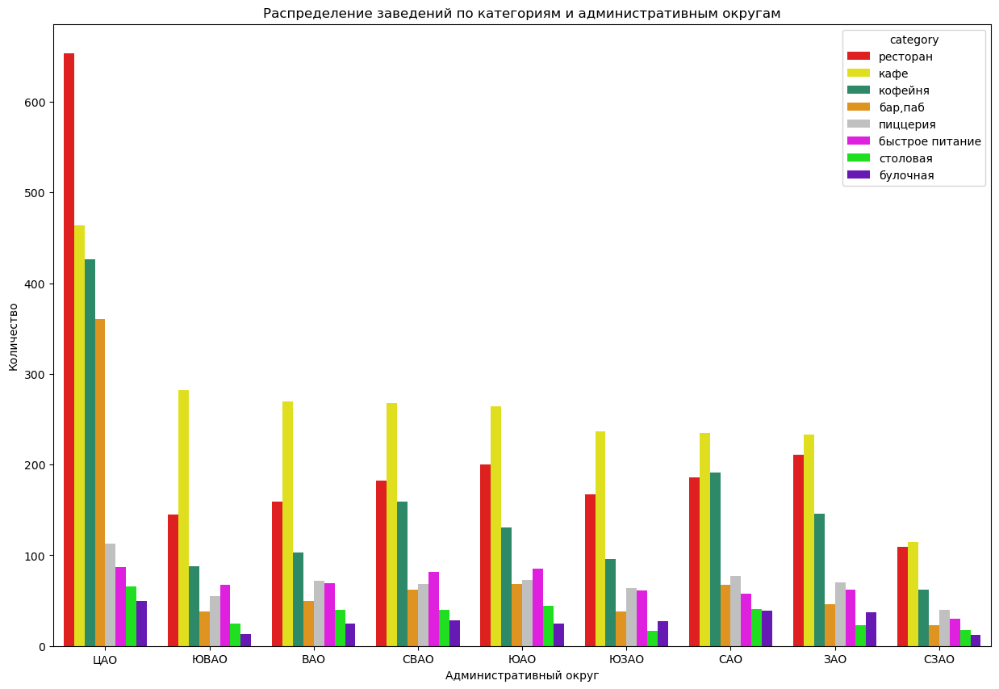

In [63]:
# построим график заведений с разбивкой по категориям
plt.figure(figsize=(15, 10))

# задание параметров построения графика
ax = sns.barplot(x=df_district_new_name_category.district_new,
                 y=df_district_new_name_category.name,
                 color='#6925c2',
                 palette=['#FF0000', '#ffff00', '#1f986c', '#FF9900', '#C0C0C0', '#ff00ff', '#00FF00', '#6600CC'],
                 hue=df_district_new_name_category.category)            
              
# подписи осей и названия
ax.set (xlabel='Административный округ',
        ylabel='Количество',
        title='Распределение заведений по категориям и административным округам');

ЦАО лидирует по всем категориям. Ресторанов больше всего в ЦАО(653. Кафе лидирует по всем АО: ЮВАО(282), ВАО(270),ЮАО(264), ЮЗАО(237), САО(235), ЗАО(234), СЗАО(115), кроме ЦАО. Меньше всего булочных и столовых по всем АО.


In [64]:
# строим столбчатую диаграмму 
fig = px.bar(df_district_new_name_category.sort_values(by='name', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             color='category', # обозначаем категорию для разделения цветом
             text='name' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределение заведений по категориям и административным округам',
                   xaxis_title='Административный округ',
                   yaxis_title='Количество')
fig.show() # выводим график

По всем категориям ЦАО лидирует: ресторан(653), кафе(464), кофейня(426). Меньше всего заведений в СЗАО: ресторан(109), кафе(115), кофейня(62).

Визуализируйте распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?

In [65]:
# группируем данные по категориям и среднему рейтингу
df_rating = df.groupby(['category'], \
                        as_index = False)[['rating']].mean().round(2).sort_values(by='rating', ascending=False)
df_rating

,category,rating
0,"бар,паб",4.39
5,пиццерия,4.30
6,ресторан,4.29
4,кофейня,4.28
1,булочная,4.27
7,столовая,4.21
3,кафе,4.13
2,быстрое питание,4.05


In [66]:
# строим столбчатую диаграмму 
fig = px.bar(df_rating.sort_values(by='rating', ascending=False), # загружаем данные и заново их сортируем
             y='rating', # указываем столбец с данными для оси X
             x='category', # указываем столбец с данными для оси Y
             text='rating', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color = 'category'
            )
# оформляем график
fig.update_layout(title='Распределение средних рейтингов по категориям заведений',
                   xaxis_title='Категории заведений',
                   yaxis_title='Рейтинг')
fig.show() # выводим график

У катагорий:быстрое питание, кафе, ресторан средний рейтинг сильно вариируется. Наивысший рейтинг у бар, паб(4.39), пиццерия(4.3), ресторан(4.29), кофейня(4.28), булочная(4.27). Наименьший рейтинг у категории быстрое питание(4.05).

Постройте фоновую картограмму (хороплет) со средним рейтингом заведений каждого района. Границы районов Москвы, которые встречаются в датасете, хранятся в файле admin_level_geomap.geojson (скачать файл для локальной работы).

In [67]:
rating_df = df.groupby('district', as_index=False)['rating'].agg('mean').sort_values(by='rating', ascending=False).round(2)
rating_df


,district,rating
5,Центральный административный округ,4.38
2,Северный административный округ,4.24
4,Северо-Западный административный округ,4.21
8,Южный административный округ,4.18
1,Западный административный округ,4.18
0,Восточный административный округ,4.17
7,Юго-Западный административный округ,4.17
3,Северо-Восточный административный округ,4.15
6,Юго-Восточный административный округ,4.10


In [68]:
# подключаем модуль для работы с JSON-форматом
import json

# читаем файл и сохраняем в переменной
with open(r"B:\Аналитик данных яндекс\Спринт 16 Как рассказать историю с помощью данных\admin_level_geomap.geojson", 'r' 
) as f:     
 
    geo_json = json.load(f)

print(json.dumps(geo_json, indent=2, ensure_ascii=False, sort_keys=True))

{
  "features": [
    {
      "geometry": {
        "coordinates": [
          [
            [
              [
                37.8756653,
                55.825342400000004
              ],
              [
                37.876001599999995,
                55.8249027
              ],
              [
                37.8730967,
                55.8237936
              ],
              [
                37.8689418,
                55.8228697
              ],
              [
                37.869206999999996,
                55.822363200000005
              ],
              [
                37.868322500000005,
                55.822211100000004
              ],
              [
                37.867472,
                55.823703
              ],
              [
                37.86851090000001,
                55.82391880000001
              ],
              [
                37.87046039999999,
                55.8242706
              ],
              [
                37.87172779999

In [69]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo =r"B:\Аналитик данных яндекс\Спринт 16 Как рассказать историю с помощью данных\admin_level_geomap.geojson"
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

По средниму рейтингу заведений каждого района наивысший рейтинг у административных округов: Центральный административный округ(4.38), Северный административный округ(4.24), Северо-Западный административный округ(4.21). Хуже всего рейтинг у административного округа Юго-Восточный административный округ(4.10).

Отобразите все заведения датасета на карте с помощью кластеров средствами библиотеки folium.

In [70]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m

Найдите топ-15 улиц по количеству заведений. Постройте график распределения количества заведений и их категорий по этим улицам. Попробуйте проиллюстрировать эту информацию одним графиком.

In [71]:
# группируем топ-15 улиц по количекству заведений
df_street_name1=df[df['street']!='неизвестен'].groupby(['street'], \
                        as_index = False)[['name']].count().sort_values(by='name', ascending=False).head(15)
df_street_name1

,street,name
1013,проспект Мира,182
741,Профсоюзная улица,122
500,Ленинский проспект,107
1010,проспект Вернадского,97
498,Ленинградский проспект,94
352,Дмитровское шоссе,87
433,Каширское шоссе,76
284,Варшавское шоссе,75
499,Ленинградское шоссе,68
519,Люблинская улица,60


In [72]:
# строим столбчатую диаграмму 
fig = px.bar(df_street_name1.sort_values(by='name', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='street', # указываем столбец с данными для оси Y
             text='name', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color = 'street'
            )
# оформляем график
fig.update_layout(title='топ-15 улиц по количеству заведений',
                   xaxis_title='Улицы',
                   yaxis_title='Количество заведений')
fig.show() # выводим график

Больше всего заведений на улицах: проспект Мира(183), Профсоюзная улица(122), Ленинский  проспект(107). Больше чем в 3 раза меньше заведений на  улицах: Пятницкая улица(48), Алтуфьевское шоссе(47, Миклухо-Маклая(47).


In [73]:
# формируем список топ-15 улиц 
df_street15 = ['проспект Мира', 'Профсоюзная улица', 'Ленинский проспект', 'проспект Вернадского','Ленинградский проспект',\
              'Дмитровское шоссе','Каширское шоссе', 'Варшавское шоссе', 'Ленинградское шоссе', 'Люблинская улица', \
               'улица Вавилова', 'Кутузовский проспект', 'Пятницкая улица', 'улица Миклухо-Маклая', 'Алтуфьевское шоссе',]
street_df15 = df.query('street in @df_street15')

In [74]:
# группируем данные по категориям по топ-15 улиц
df_street_name15 = street_df15.groupby(['street', 'category'], \
                        as_index = False)[['name']].count().sort_values(by='name', ascending=False)

df_street_name15

,street,category,name
95,проспект Мира,кафе,52
98,проспект Мира,ресторан,45
96,проспект Мира,кофейня,36
72,Профсоюзная улица,кафе,35
60,Ленинский проспект,ресторан,33
90,проспект Вернадского,ресторан,29
75,Профсоюзная улица,ресторан,26
64,Люблинская улица,кафе,26
57,Ленинский проспект,кафе,26
42,Ленинградский проспект,кофейня,25


In [75]:
df_street_name15[df_street_name15['category']=='кофейня']

,street,category,name
96,проспект Мира,кофейня,36
42,Ленинградский проспект,кофейня,25
58,Ленинский проспект,кофейня,23
73,Профсоюзная улица,кофейня,18
26,Каширское шоссе,кофейня,16
88,проспект Вернадского,кофейня,14
11,Варшавское шоссе,кофейня,14
34,Кутузовский проспект,кофейня,13
50,Ленинградское шоссе,кофейня,13
19,Дмитровское шоссе,кофейня,11


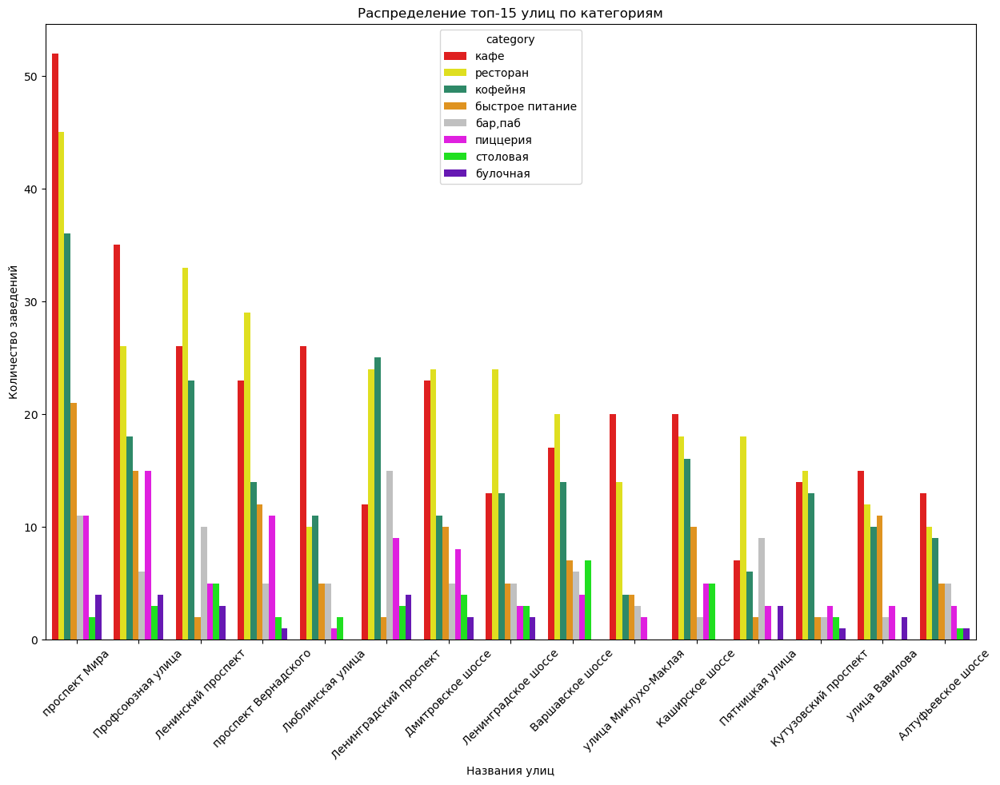

In [76]:
# построим график заведений с разбивкой по категориям
plt.figure(figsize=(15, 10))

# задание параметров построения графика
ax = sns.barplot(x=df_street_name15.street,
                 y=df_street_name15.name,
                 color='#6925c2',
                 palette=['#FF0000', '#ffff00', '#1f986c', '#FF9900', '#C0C0C0', '#ff00ff', '#00FF00', '#6600CC'],
                 hue=df_street_name15.category)            
ax.set_xticklabels(ax.get_xticklabels(),rotation = 45)              
# подписи осей и названия
ax.set (xlabel='Названия улиц',
        ylabel='Количество заведений',
        title='Распределение топ-15 улиц по категориям');

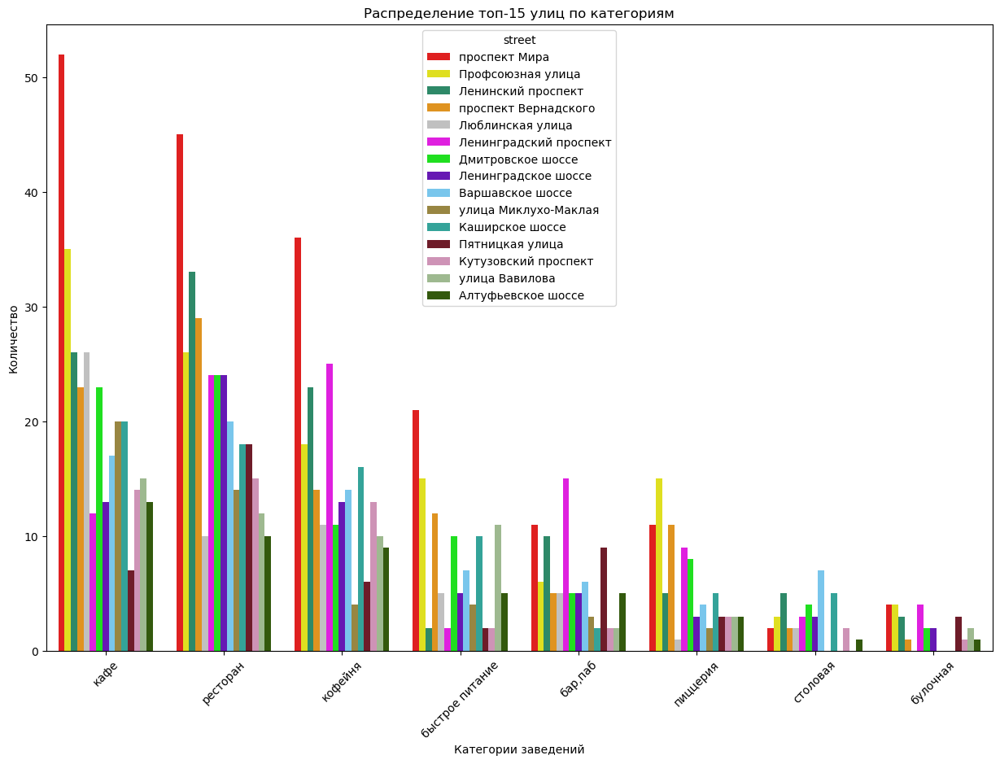

In [77]:
# построим график заведений с разбивкой по категориям
plt.figure(figsize=(15, 10))

# задание параметров построения графика
ax = sns.barplot(x=df_street_name15.category,
                 y=df_street_name15.name,
                 color='#6925c2',
                 palette=['#FF0000', '#ffff00', '#1f986c', '#FF9900', '#C0C0C0', '#ff00ff', '#00FF00', '#6600CC',\
                          '#66CCFF', '#A68E34', '#21B6A8', '#7B0F20', '#D889B8', '#9CC089', '#336600'],
                 hue=df_street_name15.street)            
ax.set_xticklabels(ax.get_xticklabels(),rotation = 45)              
# подписи осей и названия
ax.set (xlabel='Категории заведений',
        ylabel='Количество',
        title='Распределение топ-15 улиц по категориям');

In [78]:
#считаем количество заведений по топ-15 улиц
df_street_name1['name'].sum()

1217

Лидером по количеству кафе(52), ресторанов(45), кофеен(36) является проспект Мира. Большую долю на кафе приходится на улицах: Профсоюзная,  Люблинская, Миклухо-Маклая, Вавилова,а также  Алтуфьевское ,  Каширское шоссе. Большую долю на рестораны приходится на:  Ленинский , Вернадского и Кутузовский  проспекты;  Ленинградское , Дмитровское и Варшавское шоссе; Пятницкая улица. Большую долю на кофеен на Ленинградский проспекте. На Люблинской и Миклухо-Маклая улицах, Каширском и Варшавском шоссе нет булочных. На улицах: Пятницкая, Вавилова, Миклухо-Маклая не столовых. Из 1218 всего заведений по топ-15 улиц по 4 % приходится на улицы: Пятницкая(48) и Миклухо-Маклая(47).

In [79]:
# строим столбчатую диаграмму 
fig = px.bar(df_street_name15.sort_values(by='name', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='street', # указываем столбец с данными для оси Y
             color='category', # обозначаем категорию для разделения цветом
             text='name' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределения количества заведений и их категорий по улицам',
                   xaxis_title='Топ-15 улиц',
                   yaxis_title='Количество заведений')
fig.show() # выводим график

На улицах больше всего кафе(7-52), ресторанов(18-45),  кофеен(6-36).На Люблинской и Миклухо-Маклая улицах, Каширском и Варшавском шоссе нет булочных. На улицах: Пятницкая, Вавилова, Миклухо-Маклая не столовых.


Найдите улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?

In [80]:
# сформируем из топ-15 улиц, улицы с 1 заведением
df_street_name15_1 = df_street_name15[df_street_name15['name']==1]
df_street_name15_1 

,street,category,name
31,Кутузовский проспект,булочная,1
66,Люблинская улица,пиццерия,1
7,Алтуфьевское шоссе,столовая,1
85,проспект Вернадского,булочная,1
1,Алтуфьевское шоссе,булочная,1


Булочных по 1 заведению находятся на Кутузовский проспект, проспект Вернадского, Алтуфьевское шоссе. Одна пиццерия находится на Люблинской улице. Одна столовая находится на Алтуфьевском шоссе.

In [81]:
# сформируем данные с 1 заведением на улице
df_street_1 = df.groupby(['street'], \
                        as_index = False)[['name']].count().sort_values(by='street', ascending=True).reset_index()

df_street_1_all = df_street_1[df_street_1['name'] == 1]
df_street_1_all

,index,street,name
0,0,1-й Автозаводский проезд,1
1,1,1-й Балтийский переулок,1
2,2,1-й Варшавский проезд,1
3,3,1-й Вешняковский проезд,1
5,5,1-й Голутвинский переулок,1
6,6,1-й Грайвороновский проезд,1
7,7,1-й Дербеневский переулок,1
9,9,1-й Земельный переулок,1
10,10,1-й Капотнинский проезд,1
11,11,1-й Кирпичный переулок,1


In [82]:
df_street_1_all['name'].count()

410

В разных АО есть одинаковые названия улиц, поэтому будем считать количество улиц с одним заведением с разбивкой по АО.

In [83]:
# сформируем данные с 1 заведением на улице по административным округам
df_street_name_1=df.groupby(['street', 'district_new'], \
                        as_index = False)[['name']].count().sort_values(by='street', ascending=True).reset_index()
df_street1_district = df_street_name_1[df_street_name_1['name'] == 1]
df_street1_district

,index,street,district_new,name
0,0,1-й Автозаводский проезд,ЮАО,1
1,1,1-й Балтийский переулок,САО,1
2,2,1-й Варшавский проезд,ЮАО,1
3,3,1-й Вешняковский проезд,ЮВАО,1
5,5,1-й Голутвинский переулок,ЦАО,1
6,6,1-й Грайвороновский проезд,ЮВАО,1
7,7,1-й Дербеневский переулок,ЮАО,1
9,9,1-й Земельный переулок,ЦАО,1
10,10,1-й Капотнинский проезд,ЮВАО,1
11,11,1-й Кирпичный переулок,ВАО,1


In [84]:
# считаем общее количество улиц в датасете
df['street'].nunique()

1371

In [85]:
# считаем количество улиц с одним заведением
df_street1_district['name'].count()

427

In [86]:
# строим столбчатую диаграмму 
fig = px.bar(df_street1_district.sort_values(by='name', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             color='street', # обозначаем категорию для разделения цветом
             text='street' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределения улиц с одним заведением по административным округам',
                   xaxis_title='Административные округа',
                   yaxis_title='Название улиц')
fig.show() # выводим график

In [87]:
# считаем количество улиц с 1 заведением по административным округам
df_street1_count_district = df_street1_district.groupby(['district_new'], \
                        as_index = False)[['name']].sum().sort_values(by='name', ascending=False)
df_street1_count_district

,district_new,name
5,ЦАО,134
3,СВАО,50
0,ВАО,48
2,САО,47
6,ЮАО,43
1,ЗАО,36
7,ЮВАО,35
4,СЗАО,19
8,ЮЗАО,15


In [88]:
# строим столбчатую диаграмму 
fig = px.bar(df_street1_count_district.sort_values(by='name', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             color='district_new', # обозначаем категорию для разделения цветом
             text='name' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределения количество улиц с одним заведением по административным округам',
                   xaxis_title='Административные округа',
                   yaxis_title='Количество улиц')
fig.show() # выводим график

Всего 427 улиц с одним заведением. 31% приходится на ЦАО(134) . Остальные 69% распределены на 8 АО. Почти в 3 раза меньше улиц с одним заведением в АО: СВАО(50), ВАО(48), САО(47), ЮАО(43), ЗАО(36), ЮВА(35).
Почти в 9 раз меньше улиц с одним заведением в АО: СЗАО(19) и ЮЗАО(15).


Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. Посчитайте медиану этого столбца для каждого района. Используйте это значение в качестве ценового индикатора района. Постройте фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализируйте цены в центральном административном округе и других. Как удалённость от центра влияет на цены в заведениях?

In [89]:
# группируем данные по административным округам c медианным значение заказа
df_district_middle_avg_bill = df.groupby(['district'], \
                        as_index = False)[['middle_avg_bill']].median().sort_values(by='middle_avg_bill', ascending=False)
df_district_middle_avg_bill

,district,middle_avg_bill
5,Центральный административный округ,1000.0
1,Западный административный округ,975.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,550.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


In [90]:
# группируем данные по административным округам c медианным значение заказа
df_district_new_middle_avg_bill = df.groupby(['district_new'], \
                        as_index = False)[['middle_avg_bill']].median().sort_values(by='middle_avg_bill', ascending=False)
df_district_new_middle_avg_bill

,district_new,middle_avg_bill
5,ЦАО,1000.0
1,ЗАО,975.0
4,СЗАО,700.0
2,САО,650.0
8,ЮЗАО,600.0
0,ВАО,550.0
3,СВАО,500.0
6,ЮАО,500.0
7,ЮВАО,450.0


In [91]:
# строим столбчатую диаграмму 
fig = px.bar(df_district_new_middle_avg_bill.sort_values(by='middle_avg_bill', ascending=False), # загружаем данные и заново их сортируем
             y='middle_avg_bill', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             color='district_new', # обозначаем категорию для разделения цветом
             text='middle_avg_bill' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределения среднего чека в заведениях  по административным округам',
                   xaxis_title='Административные округа',
                   yaxis_title='Стоимость заказа')
fig.show() # выводим график

Выше всего средний чек ЦАО(1000), ЗАО(975).  Почти в 2 раза меньше средний чек в ВАО(550), СВАО,ЮАО(500) и ЮВАО(450).


In [92]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo =r"B:\Аналитик данных яндекс\Спринт 16 Как рассказать историю с помощью данных\admin_level_geomap.geojson"
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df_district_middle_avg_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианные значения заказов в заведениях по районам',
).add_to(m)

# выводим карту
m

Самые высокие цены в центральном административном округе(1000). На втором месте  Западный административный округ(975). На третьем месте Северо-Западный  административный округ(700). Удалённость от центра влияет на цены в заведениях. Чем дальше от центра находится заведение, тем меньше стоимость заказа. Стоимость заказа в заведениях с центра уменьшается в юго-западную часть Москвы, а затем размазывается по остальным округам.

Необязательное задание: проиллюстрируйте другие взаимосвязи, которые вы нашли в данных. Например, по желанию исследуйте часы работы заведений и их зависимость от расположения и категории заведения. Также можно исследовать особенности заведений с плохими рейтингами, средние чеки в таких местах и распределение по категориям заведений.

In [93]:
# группируем данные по административным округам c медианным значение посадочных мест
df_district_seats = df.groupby(['district'], \
                        as_index = False)[['seats']].median().sort_values(by='seats', ascending=False)
df_district_seats

,district,seats
5,Центральный административный округ,90.0
4,Северо-Западный административный округ,85.0
1,Западный административный округ,80.0
8,Южный административный округ,75.0
3,Северо-Восточный административный округ,70.0
7,Юго-Западный административный округ,69.0
2,Северный административный округ,60.0
6,Юго-Восточный административный округ,55.0
0,Восточный административный округ,50.0


In [94]:
# группируем данные по административным округам c медианным значение посадочных мест
df_district_new_seats = df.groupby(['district_new'], \
                        as_index = False)[['seats']].median().sort_values(by='seats', ascending=False)
df_district_new_seats

,district_new,seats
5,ЦАО,90.0
4,СЗАО,85.0
1,ЗАО,80.0
6,ЮАО,75.0
3,СВАО,70.0
8,ЮЗАО,69.0
2,САО,60.0
7,ЮВАО,55.0
0,ВАО,50.0


In [95]:
# строим столбчатую диаграмму 
fig = px.bar(df_district_new_seats.sort_values(by='seats', ascending=False), # загружаем данные и заново их сортируем
             y='seats', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             color='district_new', # обозначаем категорию для разделения цветом
             text='seats' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределения количество мест в заведениях по административным округам',
                   xaxis_title='Административные округа',
                   yaxis_title='Количество мест')
fig.show() # выводим график

Наибольшее количество посадочных мест в заведениях в ЦАО(90), СЗАО(85), ЗАО(80). Меньше всего посадочных мест в заведениях ЮВАО(55), ВАО(50).


In [96]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo =r"B:\Аналитик данных яндекс\Спринт 16 Как рассказать историю с помощью данных\admin_level_geomap.geojson"
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df_district_seats,
    columns=['district', 'seats'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианные значения количества посадочных мест в заведениях по районам',
).add_to(m)

# выводим карту
m

По хороплету можно сделать выводы, что количество посадочных мест в заведениях сдвинуто на северо-запад Москвы:Центральный административный округ(90.0), Северо-Западный административный округ(85.0) и Западный административный округ(80.0). Меньше всего посадочных мест в  восточном и юго-восточном административном округе Москвы.

In [97]:
#общее количество заведений
df['is_24/7'].count()

8337

In [98]:
# общее количество заведений работающих ежедневно и круглосуточно
df_true = df[df['is_24/7']==True]
df_true['is_24/7'].count()

726

In [99]:
# общее количество заведений не работающих ежедневно и круглосуточно
df_false = df[df['is_24/7']==False]
df_false['is_24/7'].count()

7611

In [100]:
# группируем данные по административным округам и количеством заведений работающих - ежедневно, круглосуточно
df_district_is_24_7 = df_true.groupby(['district'], \
                        as_index = False)[['is_24/7']].count().sort_values(by='is_24/7', ascending=False)
df_district_is_24_7

,district,is_24/7
5,Центральный административный округ,131
0,Восточный административный округ,97
6,Юго-Восточный административный округ,93
3,Северо-Восточный административный округ,75
8,Южный административный округ,74
7,Юго-Западный административный округ,73
2,Северный административный округ,71
1,Западный административный округ,69
4,Северо-Западный административный округ,43


In [101]:
# группируем данные по административным округам и количеством заведений работающих - ежедневно, круглосуточно
df_district_new_is_24_7 = df_true.groupby(['district_new'], \
                        as_index = False)[['is_24/7']].count().sort_values(by='is_24/7', ascending=False)
df_district_new_is_24_7

,district_new,is_24/7
5,ЦАО,131
0,ВАО,97
7,ЮВАО,93
3,СВАО,75
6,ЮАО,74
8,ЮЗАО,73
2,САО,71
1,ЗАО,69
4,СЗАО,43


In [102]:
# строим столбчатую диаграмму 
fig = px.bar(df_district_new_is_24_7.sort_values(by='is_24/7', ascending=False), # загружаем данные и заново их сортируем
             y='is_24/7', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             color='district_new', # обозначаем категорию для разделения цветом
             text='is_24/7' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределение заведений с  режимом работы "ежедневно, круглосуточно" по АО',
                   xaxis_title='Административные округа',
                   yaxis_title='Количество заведений')
fig.show() # выводим график

Наибольшее количество заведений с режимом работы «ежедневно, круглосуточно»  в ЦАО(131), ВАО(97), ЮВАО(93). Меньше всего заведений с режимом работы «ежедневно, круглосуточно»  СЗАО(43).


In [103]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = r"B:\Аналитик данных яндекс\Спринт 16 Как рассказать историю с помощью данных\admin_level_geomap.geojson"
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df_district_is_24_7,
    columns=['district', 'is_24/7'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество заведений работающих "ежедневно, круглосуточно" по районам',
).add_to(m)

# выводим карту
m

По хороплету видно, что больше всего заведений ежедневно и круглосуточно работают в Центральном административном округе(131). Меньше всего заведений ежедневно и круглосуточно работают в Западном(69) и Северо-Западном административном округе(43). В центре Москвы любят погулять приезжие и сами Москвичи независимо от времени суток. 

In [104]:
# группируем данные по административным округам и количеством заведений работающих - ежедневно, круглосуточно
df_is_24_7_category = df_true.groupby(['category'], \
                        as_index = False)[['is_24/7']].count().sort_values(by='is_24/7', ascending=False)
df_is_24_7_category

,category,is_24/7
3,кафе,267
2,быстрое питание,150
6,ресторан,131
4,кофейня,59
0,"бар,паб",52
5,пиццерия,31
1,булочная,24
7,столовая,12


In [105]:
# группируем данные по категориям c медианным значение заказа
df_category_middle_avg_bill1 = df.groupby(['category'], \
                        as_index = False)[['middle_avg_bill']].median().sort_values(by='middle_avg_bill', ascending=False)
df_category_middle_avg_bill1

,category,middle_avg_bill
0,"бар,паб",1250.0
6,ресторан,1250.0
5,пиццерия,600.0
3,кафе,550.0
1,булочная,450.0
4,кофейня,400.0
2,быстрое питание,375.0
7,столовая,300.0


In [106]:
# строим столбчатую диаграмму 
fig = px.bar(df_category_middle_avg_bill1.sort_values(by='middle_avg_bill', ascending=False), # загружаем данные и заново их сортируем
             y='middle_avg_bill', # указываем столбец с данными для оси X
             x='category', # указываем столбец с данными для оси Y
             color='category', # обозначаем категорию для разделения цветом
             text='middle_avg_bill' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределения среднего чека в заведениях  по категориям',
                   xaxis_title='Категории заведений',
                   yaxis_title='Стоимость заказа')
fig.show() # выводим график

Первое место по медианному занчению стоимости заказа занимают: бар,паб(1250) и ресторанами(1250). На втором месте пиццерия - 600. На третьем месте кафе 550. На последнем месте столовая - 300.

In [107]:
# считаем медианную стоимость чашки капучино в заведениях
df_middle_coffee_cup_category = df.groupby(['category'], \
                        as_index = False)[['middle_coffee_cup']].median().round(2).sort_values(by='middle_coffee_cup', ascending=False)
df_middle_coffee_cup_category

,category,middle_coffee_cup
0,"бар,паб",202.5
4,кофейня,165.0
5,пиццерия,150.0
2,быстрое питание,140.0
3,кафе,111.0
1,булочная,NaN
6,ресторан,NaN
7,столовая,NaN


In [108]:
# строим столбчатую диаграмму 
fig = px.bar(df_middle_coffee_cup_category.sort_values(by='middle_coffee_cup', ascending=False), # загружаем данные и заново их сортируем
             y='middle_coffee_cup', # указываем столбец с данными для оси X
             x='category', # указываем столбец с данными для оси Y
             color='category', # обозначаем категорию для разделения цветом
             text='middle_coffee_cup' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределения стоимости чашки капучино по категориям',
                   xaxis_title='Категории заведений',
                   yaxis_title='Стоимость чашки капучино')
fig.show() # выводим график

Дороже всего чашка капучино в бар, паб - 202.5 руб. На втором месте кофейня - 165 рублей. Дешевле всего чашка капучино в кафе - 111 рублей.

ВЫВОД:Общее количество заведений - 8340 шт. Больше всего заведений по категориям питания: кафе(2369 шт)- 28%, ресторан(2013 шт)-24%, кофейня(1402 шт) – 17%

Больше всего заведений в  ЦАО(2219).  Больше, чем в 2 раза меньше заведений в САО(895), СВАО(890), ЮАО(890), ЗАО(829), ВАО(788), ЮВАО(713), ЮЗАО(707). Почти в 5,5 раз СЗАО(409) меньше ЦАО.

Наибольшее количество посадочных мест у заведений категории: ресторан(85), бар,паб, кофейня(80), столовая(75).Меньше всего посадочных мест у булочных(50).

Наибольшее количество посадочных мест в заведениях в ЦАО(90), СЗАО(85), ЗАО(80). Меньше всего посадочных мест в заведениях ЮВАО(55), ВАО(50).

ЦАО лидирует по всем категориям. Ресторанов больше всего в ЦАО(653). Кафе лидирует по всем АО: ЮВАО(282), ВАО(270),ЮАО(264), ЮЗАО(237), САО(235), ЗАО(234), СЗАО(115), кроме ЦАО. Меньше всего булочных и столовых по всем АО.

Количество несетевых заведений (5152) на 38%  превосходит число сетевых (3188)

Наибольшая доля сетевых заведений у булочных - 61 %, пиццерий - 52% и кофеен -51%. 

Самая маленькая доля сетевых заведений у бар,паб – 22%.

1 место -кофейня(331),   2 место - ресторан(188), 3 место - пиццерия(151). На последнем месте бар,паб (4) и столовая(2).
Наивысший рейтинг у бар, паб(4.39), пиццерия(4.3), ресторан(4.29), кофейня(4.28), булочная(4.27). Наименьший рейтинг у категории быстрое питание(4.05).

Больше всего заведений на улицах: проспект Мира(183), Профсоюзная улица(122), Ленинский  проспект(107). Больше чем в 3 раза меньше заведений на  улицах: Пятницкая улица(48), Алтуфьевское шоссе(47, Миклухо-Маклая(47).

Лидером по количеству кафе(52), ресторанов(45), кофеен(36) является проспект Мира. На других улицах также лидируют кафе, рестораны,  кофейни. На Люблинской и Миклухо-Маклая улицах, Каширском и Варшавском шоссе нет булочных. На улицах: Пятницкая, Вавилова, Миклухо-Маклая не столовых.

Всего 427 улиц с одним заведением. 31% приходится на ЦАО(134) . Почти в 3 раза меньше улиц с одним заведением : СВАО(50), ВАО(48), САО(47), ЮАО(43), ЗАО(36), ЮВА(35).

Почти в 9 раз меньше улиц с одним заведением : СЗАО(19) и ЮЗАО(15).
Наибольшее количество заведений с режимом работы «ежедневно, круглосуточно»  в ЦАО(131), ВАО(97), ЮВАО(93). Меньше всего заведений с режимом работы «ежедневно, круглосуточно»  СЗАО(43).

Выше всего средний чек ЦАО(1000), ЗАО(975).  Почти в 2 раза меньше средний чек в ВАО(550), СВАО,ЮАО(500) и ЮВАО(450).



### Шаг  Детализируем исследование: открытие кофейни


- Основателям фонда «Shut Up and Take My Money» не даёт покоя успех сериала «Друзья». Их мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве. Будем считать, что заказчики не боятся конкуренции в этой сфере, ведь кофеен в больших городах уже достаточно. Попробуйте определить, осуществима ли мечта клиентов.
- Ответьте на следующие вопросы:
  - Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?
  - Есть ли круглосуточные кофейни?
  - Какие у кофеен рейтинги? Как они распределяются по районам?
  - На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?
  
По желанию вы можете расширить список вопросов для исследования, добавив собственные.

Постройте визуализации. Попробуйте дать рекомендацию для открытия нового заведения. Это творческое задание: здесь нет правильного или неправильного ответа, но ваше решение должно быть чем-то обосновано. Объяснить свою рекомендацию можно текстом с описанием или маркерами на географической карте.

In [109]:
# считаем количество кофеин в датасете
df_coffee_house = df[df['category'] == 'кофейня']
df_coffee_house['category'].count()

1402

In [110]:
# группируем данные по категориям и административным округам
df_coffee_house_district_new = df_coffee_house.groupby(['district_new'], \
                        as_index = False)[['name']].count().sort_values(by='name', ascending=False)
df_coffee_house_district_new

,district_new,name
5,ЦАО,426
2,САО,191
3,СВАО,159
1,ЗАО,146
6,ЮАО,131
0,ВАО,103
8,ЮЗАО,96
7,ЮВАО,88
4,СЗАО,62


In [111]:
# строим столбчатую диаграмму 
fig = px.bar(df_coffee_house_district_new.sort_values(by='name', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             color='district_new', # обозначаем категорию для разделения цветом
             text='name' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределение кофеен по администратитвным округам',
                   xaxis_title='Административные округа',
                   yaxis_title='Количество')
fig.show() # выводим график

In [112]:
# группируем данные по категориям и административным округам
df_coffee_house_district = df_coffee_house.groupby(['district'], \
                        as_index = False)[['category']].count().sort_values(by='category', ascending=False)
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = r"B:\Аналитик данных яндекс\Спринт 16 Как рассказать историю с помощью данных\admin_level_geomap.geojson"
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df_coffee_house_district,
    columns=['district', 'category'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество кофеен по районам',
).add_to(m)

# выводим карту
m

Больше всего кофеен в Центральном административном округе(426). На втором месте Северный административный округ(191), на третьем месте Северо-Восточный административный округ(159).Меньше всего кофеен в Северо-Западном административном округе(62).

In [113]:
# считаем количество круглдосуточных кофеен
df_coffee_house_is_24_7 = df_coffee_house[df_coffee_house['is_24/7'] == True]
df_coffee_house_is_24_7['is_24/7'].count()

59

In [114]:
# считаем количество круглосуточных заведений
df_is_24_7 = df[df['is_24/7'] == True]
df_is_24_7['is_24/7'].count()

726

In [115]:
# считаем сколько процентов от общего количества приходится на кофеейни
(df_coffee_house_is_24_7['is_24/7'].count()/ df_is_24_7['is_24/7'].count()*100).round(2)

8.13

In [116]:
# группируем данные по административным округам и количеством кофеен работающих - ежедневно, круглосуточно
df_5 = df[df['is_24/7'] != False].groupby(['category'], \
                        as_index = False)[['is_24/7']].count().sort_values(by='is_24/7', ascending=False)
df_5

,category,is_24/7
3,кафе,267
2,быстрое питание,150
6,ресторан,131
4,кофейня,59
0,"бар,паб",52
5,пиццерия,31
1,булочная,24
7,столовая,12


In [117]:
# группируем данные по административным округам и количеством кофеен работающих - ежедневно, круглосуточно
df_coffee_house_district_new_24_7 = df_coffee_house_is_24_7.groupby(['district_new'], \
                        as_index = False)[['is_24/7']].count().sort_values(by='is_24/7', ascending=False)
df_coffee_house_district_new_24_7

,district_new,is_24/7
5,ЦАО,26
1,ЗАО,9
8,ЮЗАО,7
0,ВАО,5
2,САО,5
3,СВАО,3
4,СЗАО,2
6,ЮАО,1
7,ЮВАО,1


In [118]:
# строим столбчатую диаграмму 
fig = px.bar(df_coffee_house_district_new_24_7.sort_values(by='is_24/7', ascending=False), # загружаем данные и заново их сортируем
             y='is_24/7', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             color='district_new', # обозначаем категорию для разделения цветом
             text='is_24/7' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределение кофеен с режимом работы "ежедневно,круглосуточно"',
                   xaxis_title='Административные округа',
                   yaxis_title='Количество')
fig.show() # выводим график

Из 726  заведений с режимом работы «ежедневно, круглосуточно» 59(8%) кофеен. Больше всего ЦАО(26). Почти в 3 раза меньше в ЗАО(9). Меньше всего в ЮАО и ЮВАО по 1 кофейне .


In [119]:
# группируем данные по административным округам и количеством кофеен работающих - ежедневно, круглосуточно
df_coffee_house_district_24_7 = df_coffee_house_is_24_7.groupby(['district'], \
                        as_index = False)[['is_24/7']].count().sort_values(by='is_24/7', ascending=False)
df_coffee_house_district_24_7

,district,is_24/7
5,Центральный административный округ,26
1,Западный административный округ,9
7,Юго-Западный административный округ,7
0,Восточный административный округ,5
2,Северный административный округ,5
3,Северо-Восточный административный округ,3
4,Северо-Западный административный округ,2
6,Юго-Восточный административный округ,1
8,Южный административный округ,1


Больше всего кофеен в Центральном административном округе(26). На втором месте Западный административный округ(9) - это почти в 3 раза меньше, чем в Центральном административном округе. На третьем месте Юго-Западном административном округе(7). По одному заведению в Юго-Восточном и Южном административных округах.

In [120]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = r"B:\Аналитик данных яндекс\Спринт 16 Как рассказать историю с помощью данных\admin_level_geomap.geojson"
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df_coffee_house_district_24_7,
    columns=['district', 'is_24/7'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество кофеен работающих "ежедневно, круглосуточно" по районам',
).add_to(m)

# выводим карту
m

In [121]:
rating_df_coffee_house_district_new = df_coffee_house.groupby('district_new', as_index=False)['rating'].agg('mean').sort_values(by='rating', ascending=False).round(2)

# строим столбчатую диаграмму 
fig = px.bar(rating_df_coffee_house_district_new.sort_values(by='rating', ascending=False), # загружаем данные и заново их сортируем
             y='rating', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             text='rating', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color = 'district_new'
            )
# оформляем график
fig.update_layout(title='Распределение средних рейтингов кофеен по АО',
                   xaxis_title='Административные округа',
                   yaxis_title='Рейтинг')
fig.show() # выводим график

Наивысший рейтинг у ЦАО(4.34). У остальных АО средний рейтинг не сильно отличается: СЗАО(4.33), САО(4.29), ВАО(4.29), ЮЗАО(4.28), ЮАО(4.23), ЮВАО(4.23), СВАО(4.22), ЗАО(4.19) . 


In [122]:
# группируем данные кофеен по  административным округам
df_coffee_house_rating = df_coffee_house.groupby(['district'], \
                        as_index = False)[['rating']].mean().round(2).sort_values(by='rating', ascending=False)
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = r"B:\Аналитик данных яндекс\Спринт 16 Как рассказать историю с помощью данных\admin_level_geomap.geojson"
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df_coffee_house_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество кофеен по районам в зависимости от рейтинга',
).add_to(m)

# выводим карту
m

In [123]:
df_coffee_house_district_middle_coffee_cup = df_coffee_house.groupby(['district_new','middle_coffee_cup']).agg({'name':'count'}).sort_values(by='name', ascending=False).reset_index()
df_coffee_house_district_middle_coffee_cup

,district_new,middle_coffee_cup,name
0,ЦАО,256.0,15
1,ЦАО,95.0,12
2,ЦАО,60.0,11
3,ЦАО,225.0,10
4,САО,150.0,7
5,ЦАО,275.0,6
6,СВАО,95.0,6
7,ЦАО,250.0,6
8,ЗАО,256.0,6
9,СВАО,170.0,6


In [124]:
# считаем медианную стоимость чашки капучино в кофейне
df_coffee_house_middle_coffee_cup = df_coffee_house.groupby(['district_new'], \
                        as_index = False)[['middle_coffee_cup']].median().round(2).sort_values(by='middle_coffee_cup', ascending=False)
df_coffee_house_middle_coffee_cup

,district_new,middle_coffee_cup
8,ЮЗАО,198.0
5,ЦАО,187.5
1,ЗАО,187.0
4,СЗАО,165.0
3,СВАО,162.5
2,САО,157.0
6,ЮАО,150.0
7,ЮВАО,145.0
0,ВАО,135.0


In [125]:
# строим столбчатую диаграмму 
fig = px.bar(df_coffee_house_middle_coffee_cup.sort_values(by='middle_coffee_cup', ascending=False), # загружаем данные и заново их сортируем
             y='middle_coffee_cup', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             text='middle_coffee_cup', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color = 'district_new'
            )
# оформляем график
fig.update_layout(title='Распределение в кофейне средней стоимости чашки капучино по АО',
                   xaxis_title='Административные округа',
                   yaxis_title='Стоимость чашки капучино')
fig.show() # выводим график

На 1 месте по стоимости чашки капучино в кофейне
ЮЗАО(198). 
На 2 месте ЦАО(187.50).
На 3 месте ЗАО(187).
Самое дешевое капучино в ВАО(135).


In [126]:
# общая стоимость чашек по данным
df_coffee_house['middle_coffee_cup'].sum()

87717.0

In [127]:
# общее количество чашек
df_coffee_house['middle_coffee_cup'].count()

514

In [128]:
# средняя цена одной чашки капучино
cup_price = df_coffee_house['middle_coffee_cup'].sum() / df_coffee_house['middle_coffee_cup'].count()
cup_price.round()

171.0

При открытии кофейни можно ориентироваться на стоимость чашки  не выше 171 руб. 

In [129]:
# считаем Топ-15 улиц кофеен 
df_coffee_house_district_street = df_coffee_house[df_coffee_house['street'] != 'неизвестен'].groupby(['street']).agg({'name':'count'}).sort_values(by='name', ascending=False).head(15).reset_index()
df_coffee_house_district_street

,street,name
0,проспект Мира,36
1,Ленинградский проспект,25
2,Ленинский проспект,23
3,Профсоюзная улица,18
4,Каширское шоссе,16
5,Варшавское шоссе,14
6,проспект Вернадского,14
7,Кутузовский проспект,13
8,Новослободская улица,13
9,Ленинградское шоссе,13


In [130]:
# строим столбчатую диаграмму 
fig = px.bar(df_coffee_house_district_street.sort_values(by='name', ascending=False), # загружаем данные и заново их сортируем
             y='name', # указываем столбец с данными для оси X
             x='street', # указываем столбец с данными для оси Y
             text='name', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color = 'street'
            )
# оформляем график
fig.update_layout(title='топ-15 улиц по количеству кофеен',
                   xaxis_title='Улицы',
                   yaxis_title='Количество')
fig.show() # выводим график

In [131]:
# формируем список топ-15 улиц по кофейням
df_street15_coffe = ['проспект Мира', 'Ленинградский проспект' , 'Ленинский проспект', 'Профсоюзная улица' ,'Каширское шоссе', \
               'Варшавское шоссе', 'проспект Вернадского', 'Кутузовский проспект', 'Новослободская улица', 'Ленинградское шоссе',\
               'Новодмитровская улица', 'Дмитровское шоссе', 'Люблинская улица', 'улица Вавилова', 'Береговой проезд']
          
street_coffe_df15 = df_coffee_house.query('street in @df_street15_coffe')

In [132]:
# считаем Топ-15 улиц кофеен по АО
df_coffee_house_district_new_street = street_coffe_df15.groupby(['district_new','street'])\
                                   .agg({'name':'count'}).sort_values(by='name', ascending=False).reset_index()
df_coffee_house_district_new_street

,district_new,street,name
0,САО,Ленинградский проспект,25
1,СВАО,проспект Мира,19
2,ЮЗАО,Профсоюзная улица,18
3,ЮЗАО,Ленинский проспект,18
4,ЦАО,проспект Мира,17
5,ЮАО,Каширское шоссе,16
6,ЗАО,проспект Вернадского,14
7,ЮАО,Варшавское шоссе,14
8,САО,Ленинградское шоссе,13
9,ЗАО,Кутузовский проспект,13


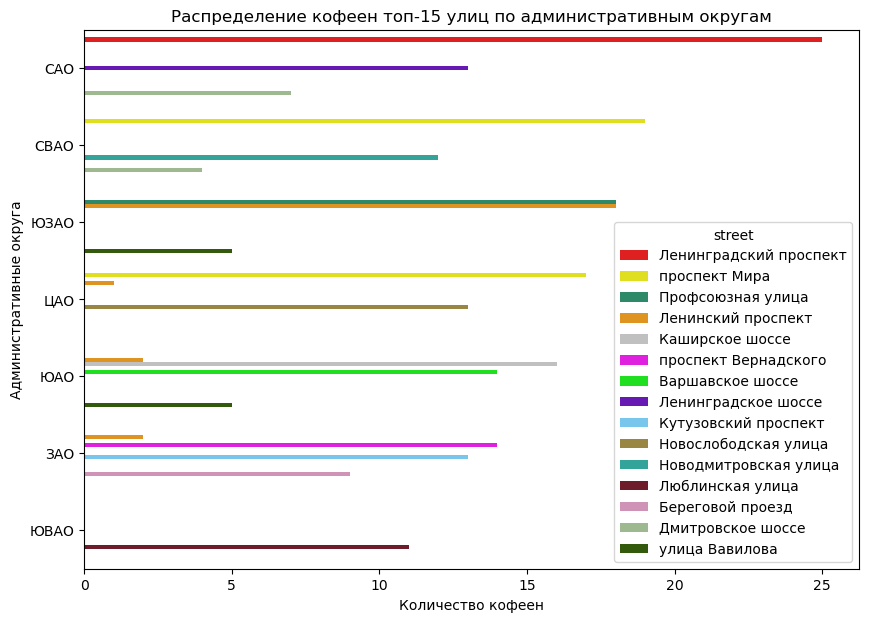

In [133]:
# построим график заведений с разбивкой по категориям
plt.figure(figsize=(10, 7))

# задание параметров построения графика
ax = sns.barplot(y=df_coffee_house_district_new_street.district_new,
                 x=df_coffee_house_district_new_street.name,
                 color='#6925c2',
                 palette=['#FF0000', '#ffff00', '#1f986c', '#FF9900', '#C0C0C0', '#ff00ff', '#00FF00', '#6600CC',\
                          '#66CCFF', '#A68E34', '#21B6A8', '#7B0F20', '#D889B8', '#9CC089', '#336600'],
                 hue=df_coffee_house_district_new_street.street)            
#ax.set_xticklabels(ax.get_xticklabels(),rotation = 45)              
# подписи осей и названия
ax.set (xlabel='Количество кофеен',
        ylabel='Административные округа',
        title='Распределение кофеен топ-15 улиц по административным округам');

Больше всего кофеен находится на проспекте Мира - 36: СВАО(19), ЦАО(17).На 2 месте кофейни, которые находятся на  Ленинградском проспекте - САО(25). На 3 месте Ленинский проспект- 23: ЮЗАО(18), ЮАО(2), ЗАО(2), ЦАО(1). На Профсоюзной улице ЮЗАО(18). На Каширском шоссе ЮАО(16). На Варшавском шоссе ЮАО(14) и проспекте Вернадского ЗАО(14). На Кутузовском проспекте	ЗАО(13), Новослободской улице ЦАО(13), Ленинградском шоссе САО(13). На Новодмитровской улице СВАО(12). На Дмитровском шоссе - 11: САО(7), СВАО(4). На Люблинской улице ЮВАО(11). На улице Вавилова - 10: ЮАО(5), ЮЗАО(5). На Береговом проезде ЗАО(9).

In [134]:
# формируем улицы c 1 кофейней
df_coffee_house_district_street1 = df_coffee_house.groupby(['street']).agg({'name':'count'}).sort_values(by='name', ascending=True).reset_index()
df_coffee_house_district_street11 = df_coffee_house_district_street1[df_coffee_house_district_street1['name'] == 1]
df_coffee_house_district_street11

,street,name
0,1-й Волоколамский проезд,1
1,Семёновский переулок,1
2,Семёновская площадь,1
3,Селивёрстов переулок,1
4,Севастопольский проспект,1
5,Светлогорский проезд,1
6,Саратовская улица,1
7,Самотёчная улица,1
8,Садовая-Черногрязская улица,1
9,Садовая-Триумфальная улица,1


In [135]:
# считаем улицы c 1 кофейней
df_coffee_house_district_street11['name'].count()

352

In [136]:
# общее количество улиц
df_coffee_house['name'].count()

1402

Улиц с 1 кофейней 352 шт. Всего кофеен 1402. Из этого можно сделать вывод, что 4 часть из всех кофеен располагаются по одному на улице.

In [137]:
# группируем данные по категориям и административным округам
df_coffee_house_chain = df_coffee_house.groupby(['chain'], \
                        as_index = False)[['name']].count().sort_values(by='name', ascending=False)
df_coffee_house_chain

,chain,name
1,1,714
0,0,688


In [138]:
# строим столбчатую диаграмму 
fig = px.bar(df_coffee_house_chain.sort_values(by='name', ascending=False), # загружаем данные и заново их сортируем
             x='chain', # указываем столбец с данными для оси X
             y='name', # указываем столбец с данными для оси Y
             text='name', # добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
             color='chain', # обозначаем категорию для разделения цветом
            )
# оформляем график
fig.update_layout(title='Количество сетевых и несетевых кофеен',
                   xaxis_title='Сетевые и несетевые кофейни',
                   yaxis_title='Количество кофеен')
fig.show() # выводим график

Сетевых кофеен 714 - это 51% от общего количества кофеен(714/1402). Не сетевых кофеен 688 - это 49% от общего количества кофеен(688/1402)

In [139]:
# группируем данные по административным округам c медианным значение заказа кофеен
district_new_middle_avg_bill_df_coffee_house = df_coffee_house.groupby(['district_new'], \
                        as_index = False)[['middle_avg_bill']].median().sort_values(by='middle_avg_bill', ascending=False)
district_new_middle_avg_bill_df_coffee_house

,district_new,middle_avg_bill
1,ЗАО,600.0
5,ЦАО,500.0
0,ВАО,400.0
6,ЮАО,387.5
8,ЮЗАО,375.0
2,САО,325.0
3,СВАО,325.0
4,СЗАО,325.0
7,ЮВАО,250.0


In [140]:
# строим столбчатую диаграмму 
fig = px.bar(district_new_middle_avg_bill_df_coffee_house.sort_values(by='middle_avg_bill', ascending=False), # загружаем данные и заново их сортируем
             y='middle_avg_bill', # указываем столбец с данными для оси X
             x='district_new', # указываем столбец с данными для оси Y
             color='district_new', # обозначаем категорию для разделения цветом
             text='middle_avg_bill' # добавляем аргумент, который отобразит текст с информацией
                           # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Распределения среднего чека в кофейнях по административным округам',
                   xaxis_title='Административные округа',
                   yaxis_title='Стоимость заказа')
fig.show() # выводим график

Самый высокий средний чек в кофейне в ЗАО(600). На 2 месте ЦАО(500). На 3 месте ЮАО(400). Самый низкий средний чек в кофейне в ЮВАО(250).

**Вывод 4 шаг**:
Больше всего кофеен в ЦАО(426). На втором месте САО(191), на третьем месте ССВАО159).Меньше всего кофеен в СЗАО(62).  

Из 726 заведений с режимом работы «ежедневно, круглосуточно» 59(8%) кофеен. Больше всего ЦАО(26). Почти в 3 раза меньше в ЗАО(9). Меньше всего в ЮАО и ЮВАО по 1 кофейне.

Больше всего кофеен в ЦАО(26). На втором месте ЗАО(9) - это почти в 3 раза меньше, чем в ЦАО. На третьем месте ЮЗАО(7). По одному заведению в ЮВАО и ЮАО.

Наивысший рейтинг у ЦАО(4.34). У остальных АО средний рейтинг не сильно отличается: СЗАО(4.33), САО(4.29), ВАО(4.29), ЮЗАО(4.28), ЮАО(4.23), ЮВАО(4.23), СВАО(4.22), ЗАО(4.19).

На 1 месте по стоимости чашки капучино в кофейне ЮЗАО(198). На 2 месте ЦАО(187.50). На 3 месте ЗАО(187). Самое дешевое капучино в ВАО(135).

При открытии кофейни можно ориентироваться на стоимость чашки капучино не выше 171 руб.

Больше всего кофеен находится на проспекте Мира - 36: СВАО(19), ЦАО(17).На 2 месте кофейни, которые находятся на Ленинградском проспекте - САО(25). На 3 месте Ленинский проспект- 23: ЮЗАО(18), ЮАО(2), ЗАО(2), ЦАО(1). На Профсоюзной улице ЮЗАО(18). На Каширском шоссе ЮАО(16). На Варшавском шоссе ЮАО(14) и проспекте Вернадского ЗАО(14). На Кутузовском проспекте ЗАО(13), Новослободской улице ЦАО(13), Ленинградском шоссе САО(13). На Новодмитровской улице СВАО(12). На Дмитровском шоссе - 11: САО(7), СВАО(4). На Люблинской улице ЮВАО(11). На улице Вавилова - 10: ЮАО(5), ЮЗАО(5). На Береговом проезде ЗАО(9).

Улиц с 1 кофейней 352 шт. Всего кофеен 1402. Из этого можно сделать вывод, что 4 часть из всех кофеен располагаются по одному на улице.

Сетевых кофеен 714 - это 51% от общего количества кофеен(714/1402). Не сетевых кофеен 688 - это 49% от общего количества кофеен(688/1402).

Самый высокий средний чек в кофейне в ЗАО(600). На 2 месте ЦАО(500). На 3 месте ЮАО(400). Самый низкий средний чек в кофейне в ЮВАО(250).

Общие выводы по исседованию: 
- Кофейня – находится на 3 месте по популярности среди всех заведений (17 %) 
- Кофейня популярно для работы в сети (51 % сетевых заведений среди всех кофеен).
- Средний чек в кофейне 400 рублей 
- Средняя вместимость кофеен - 80 мест
- Из 726 заведений работающих ежедневно, круглосуточно - 8 % приходится на кофейни(59)
- Средний рейтинг кофейни - 4.28
- Средняя стоимость чашки капучино в кофейне 171 рубль
- В Москве больше всего кофеен на проспектах: Мира(36), Ленинградском(25), Ленинском(23).
- Больше всего кофеен в центральном административном округе


РЕКОМЕНДАЦИИ: 
- Ограничиться максимальной вместимостью кофейни в 80 человек
- Продумать меню для увеличения среднего чека стоимости заказа
- Открыть кофейню с ежедневным, круглосуточным режимом работы 
- Продумать концепцию увеличения среднего рейтинга кофейни
- Стоимость чашки капучино в кофейне установить не выше 171 рубля 
- Не открывать кофейни на магистральных улицах, связывающих центр Москвы и МКАД 
- Избегать популярных улиц кофеен на проспектах: Мира, Ленинградском, Ленинском.  
- Рассмотреть открытие кофейни на улицах: Пятницкая и Миклухо-Маклая
- Провести дополнительное исследование по кофейни и тому, что приносит популярность


Презентация: <https://drive.google.com/drive/folders/1OnIjt95GUm_-HSXpUh7HeVcRJ49ei42z?usp=sharing> 